In [109]:
# Copyright (c) Meta Platforms, Inc. and affiliates.

# Video segmentation with SAM 2

This notebook shows how to use SAM 2 for interactive segmentation in videos. It will cover the following:

- adding clicks (or box) on a frame to get and refine _masklets_ (spatio-temporal masks)
- propagating clicks (or box) to get _masklets_ throughout the video
- segmenting and tracking multiple objects at the same time

We use the terms _segment_ or _mask_ to refer to the model prediction for an object on a single frame, and _masklet_ to refer to the spatio-temporal masks across the entire video. 

<a target="_blank" href="https://colab.research.google.com/github/facebookresearch/segment-anything-2/blob/main/notebooks/video_predictor_example.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

## Environment Set-up

If running locally using jupyter, first install `segment-anything-2` in your environment using the [installation instructions](https://github.com/facebookresearch/segment-anything-2#installation) in the repository.

If running from Google Colab, set `using_colab=True` below and run the cell. In Colab, be sure to select 'GPU' under 'Edit'->'Notebook Settings'->'Hardware accelerator'. Note that it's recommended to use **A100 or L4 GPUs when running in Colab** (T4 GPUs might also work, but could be slow and might run out of memory in some cases).

In [110]:
using_colab = False

In [111]:
if using_colab:
    import torch
    import torchvision
    print("PyTorch version:", torch.__version__)
    print("Torchvision version:", torchvision.__version__)
    print("CUDA is available:", torch.cuda.is_available())
    import sys
    !{sys.executable} -m pip install opencv-python matplotlib
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything-2.git'

    !mkdir -p videos
    !wget -P videos https://dl.fbaipublicfiles.com/segment_anything_2/assets/bedroom.zip
    !unzip -d videos videos/bedroom.zip

    !mkdir -p ../checkpoints/
    !wget -P ../checkpoints/ https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_large.pt

## Set-up

In [112]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib


# Set the GPU number (e.g., GPU 0)
os.environ["CUDA_VISIBLE_DEVICES"] = "2"

In [113]:
# use bfloat16 for the entire notebook
torch.autocast(device_type="cuda", dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

### Loading the SAM 2 video predictor
#### Here you should specify your model checkpoint path

In [114]:
from sam2.build_sam import build_sam2_video_predictor

sam2_checkpoint = "/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/segment-anything-2/checkpoints/sam2_hiera_large.pt"
model_cfg = "sam2_hiera_l.yaml"

predictor = build_sam2_video_predictor(model_cfg, sam2_checkpoint)

In [115]:
def show_mask(mask, ax, obj_id=None, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        cmap = plt.get_cmap("tab10")
        cmap_idx = 0 if obj_id is None else obj_id
        color = np.array([*cmap(cmap_idx)[:3], 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_points(coords, labels, ax, marker_size=200):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)


def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))

# Function to save the mask
def save_mask(mask, save_path):
    # Remove the channel dimension if it's there
    mask = mask.squeeze(0)  # shape becomes (256, 256)
    
    # Convert boolean mask to uint8 (0 or 255)
    mask_img = (mask * 255).astype(np.uint8)
    
    # Create an Image object and save it
    mask_image = Image.fromarray(mask_img)
    mask_image.save(save_path)

# Function to merge masks and save the combined mask
def merge_and_save_masks(masks, save_path):
    # Assuming all masks have the same shape, get the shape of one mask
    combined_mask = np.zeros_like(list(masks.values())[0], dtype=np.uint8)
    
    # Merge all masks together
    for mask in masks.values():
        combined_mask = np.maximum(combined_mask, mask.astype(np.uint8))
    
    # Convert to an image and save
    combined_mask_img = Image.fromarray(combined_mask[0] * 255)  # Scale boolean to 0-255
    combined_mask_img.save(save_path)

#### Select an example video

We assume that the video is stored as a list of JPEG frames with filenames like `<frame_index>.jpg`.

For your custom videos, you can extract their JPEG frames using ffmpeg (https://ffmpeg.org/) as follows:
```
ffmpeg -i <your_video>.mp4 -q:v 2 -start_number 0 <output_dir>/'%05d.jpg'
```
where `-q:v` generates high-quality JPEG frames and `-start_number 0` asks ffmpeg to start the JPEG file from `00000.jpg`.

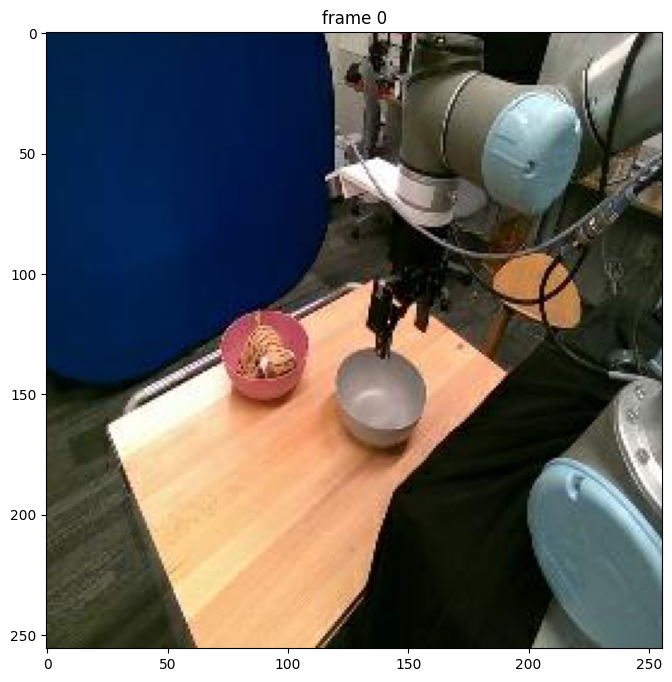

In [116]:
# So the list is the clip video we want to process, and the video_dir is the directory of the video!
lists = range(0, 1)
#note that the root_path do not attach
root_path = "/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language"
mask_path = "/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask"
# sort the video directories
def extract_clip_id(file_name):
    return int(file_name.split('_')[-1])

video_dirs = [os.path.join(root_path, sorted(os.listdir(root_path), key=extract_clip_id)[i]) for i in lists]
image_lists = []
for video_dir in video_dirs:
    # scan all the JPEG frame names in this directory
    frame_names = [
        p for p in os.listdir(video_dir)
        if os.path.splitext(p)[-1] in [".jpg", ".jpeg", ".JPG", ".JPEG"]
    ]
    frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))
    for frame_name in frame_names:
        image_lists.append(os.path.join(video_dir, frame_name))
    
    # take a look the first video frame
    frame_idx = 0
    plt.figure(figsize=(12, 8))
    plt.title(f"frame {frame_idx}")
    plt.imshow(Image.open(os.path.join(video_dir, frame_names[frame_idx])))

video_dir = image_lists

#### Initialize the inference state

In [117]:
video_dir

['/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berkeley_autolab_ur5_traj_0/0.jpg',
 '/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berkeley_autolab_ur5_traj_0/1.jpg',
 '/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berkeley_autolab_ur5_traj_0/2.jpg',
 '/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berkeley_autolab_ur5_traj_0/3.jpg',
 '/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berkeley_autolab_ur5_traj_0/4.jpg',
 '/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berkeley_autolab_ur5_traj_0/5.jpg',
 '/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berkeley_autolab_ur5_traj_0/6.jpg',
 '/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language/berk

SAM 2 requires stateful inference for interactive video segmentation, so we need to initialize an **inference state** on this video.

During initialization, it loads all the JPEG frames in `video_path` and stores their pixels in `inference_state` (as shown in the progress bar below).

In [118]:
inference_state = predictor.init_state(video_path=video_dir)

frame loading (JPEG):   0%|          | 0/118 [00:00<?, ?it/s]

frame loading (JPEG): 100%|██████████| 118/118 [00:07<00:00, 15.40it/s]


### Example 1: Segment & track one object

Note: if you have run any previous tracking using this `inference_state`, please reset it first via `reset_state`.

(The cell below is just for illustration; it's not needed to call `reset_state` here as this `inference_state` is just freshly initialized above.)

In [119]:
predictor.reset_state(inference_state)

#### Step 1: Add a first click on a frame

To get started, let's try to segment the child on the left.

Here we make a **positive click** at (x, y) = (210, 350) with label `1`, by sending their coordinates and labels into the `add_new_points_or_box` API.

Note: label `1` indicates a *positive click (to add a region)* while label `0` indicates a *negative click (to remove a region)*.

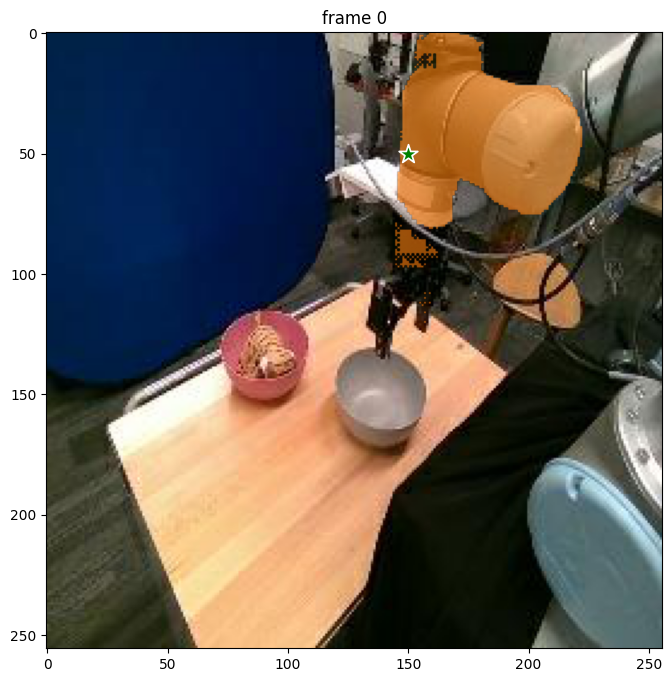

In [120]:
ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with (it can be any integers)

# Let's add a positive click at (x, y) = (210, 350) to get started
points = np.array([[150, 50]], dtype=np.float32)
# for labels, `1` means positive click and `0` means negative click
labels = np.array([1], np.int32)
_, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# show the results on the current (interacted) frame
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(video_dir[ann_frame_idx]))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

#### Step 2: Add a second click to refine the prediction

Hmm, it seems that although we wanted to segment the child on the left, the model predicts the mask for only the shorts -- this can happen since there is ambiguity from a single click about what the target object should be. We can refine the mask on this frame via another positive click on the child's shirt.

Here we make a **second positive click** at (x, y) = (250, 220) with label `1` to expand the mask.

Note: we need to send **all the clicks and their labels** (i.e. not just the last click) when calling `add_new_points_or_box`.

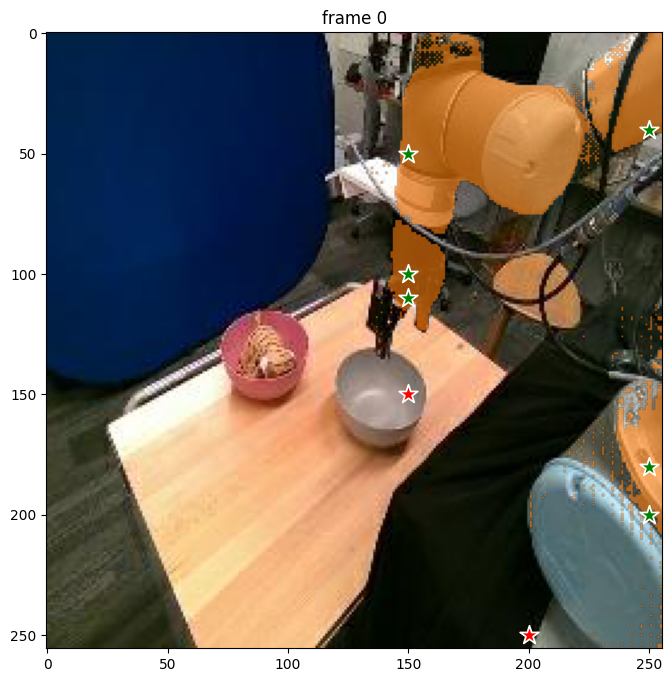

In [121]:
ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with (it can be any integers)

# Let's add a 2nd positive click at (x, y) = (250, 220) to refine the mask
# sending all clicks (and their labels) to `add_new_points_or_box`
points = np.array([[150, 50], [150, 110], [150, 100], [250, 200], [250, 40], [250, 180], [200, 250], [150, 150]], dtype=np.float32)
# for labels, `1` means positive click and `0` means negative click
labels = np.array([1, 1, 1, 1, 1, 1, 0, 0], np.int32)
_, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# show the results on the current (interacted) frame
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(video_dir[ann_frame_idx]))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

With this 2nd refinement click, now we get a segmentation mask of the entire child on frame 0.

#### Step 3: Propagate the prompts to get the masklet across the video

To get the masklet throughout the entire video, we propagate the prompts using the `propagate_in_video` API.

propagate in video: 100%|██████████| 118/118 [00:07<00:00, 15.22it/s]


/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/0.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/1.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/2.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/3.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/4.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/5.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/6.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language

/tmp/ipykernel_1243654/1058047571.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 4))


/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/20.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/21.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/22.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/23.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/24.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/25.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/26.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_l

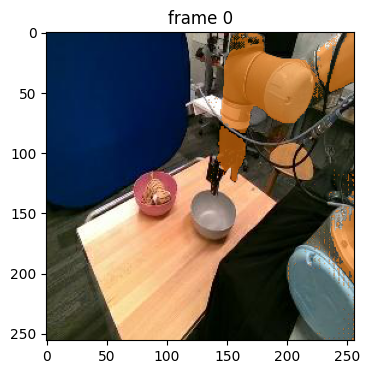

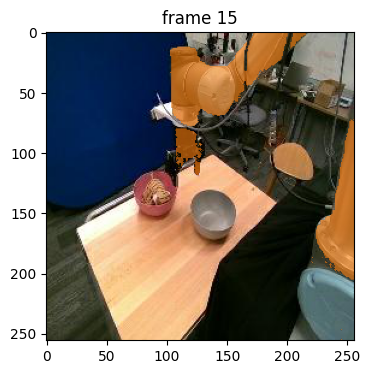

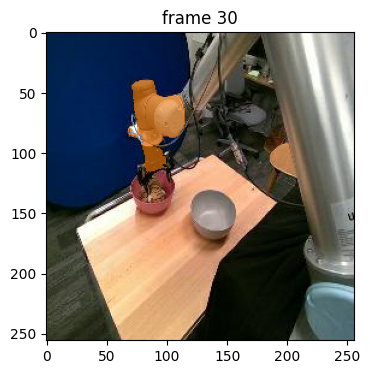

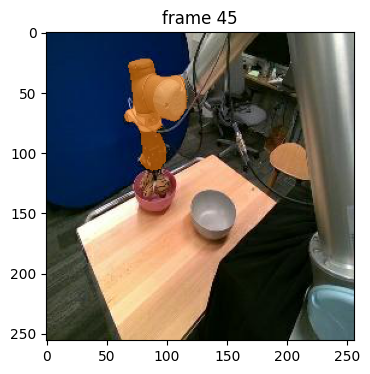

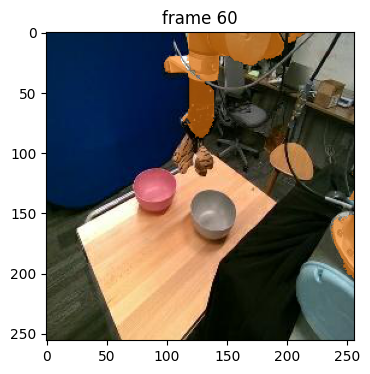

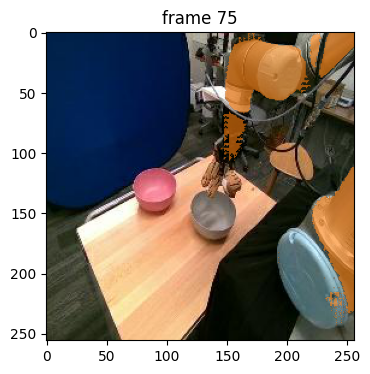

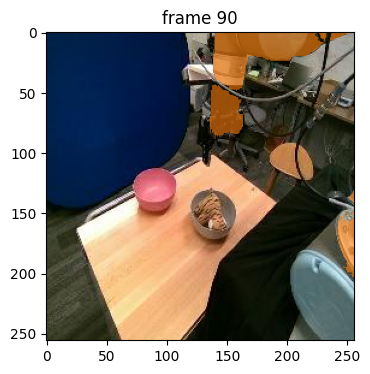

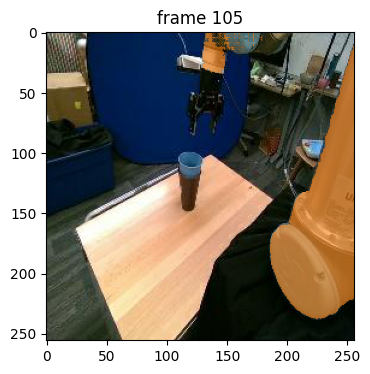

In [122]:
# run propagation throughout the video and collect the results in a dict
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# Iterate over all frames
for out_frame_idx in range(0, len(video_dir), 1):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(video_dir[out_frame_idx]))
    
    # Show and merge masks for each object in the frame
    masks = {}
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
        masks[out_obj_id] = out_mask
    
    save_path = os.path.join(mask_path, video_dir[out_frame_idx].split('/')[-2])
    # Save the merged mask
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    save_image_path = os.path.join(save_path, video_dir[out_frame_idx].split('/')[-1])
    print(save_image_path)
    merge_and_save_masks(masks, save_image_path)

# render the segmentation results every few frames
vis_frame_stride = 15
plt.close("all")
for out_frame_idx in range(0, len(frame_names), vis_frame_stride):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(video_dir[out_frame_idx]))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)

#### Step 4: Add new prompts to further refine the masklet

It appears that in the output masklet above, there are some imperfections in boundary details on frame 150.

With SAM 2 we can fix the model predictions interactively. We can add a **negative click** at (x, y) = (82, 415) on this frame with label `0` to refine the masklet. Here we call the `add_new_points_or_box` API with a different `frame_idx` argument to indicate the frame index we want to refine.

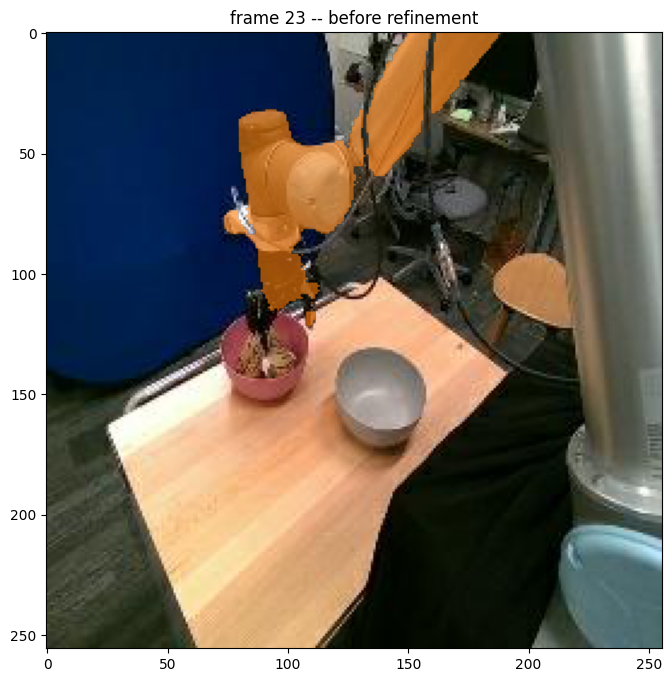

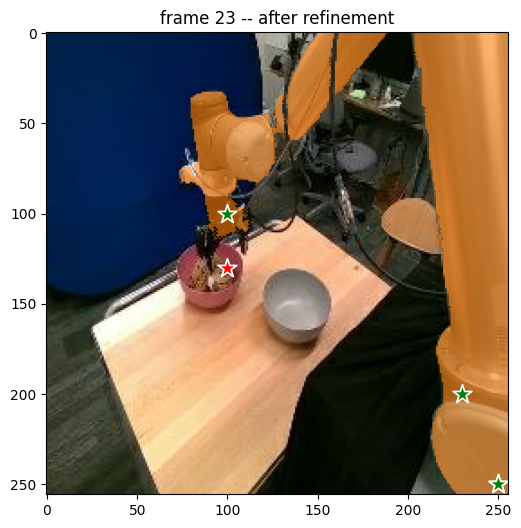

In [128]:
# In[29]:
refine_clip_id = 0
ann_frame_idx = 23  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with (it can be any integers)


def extract_clip_id(file_name):
    return int(file_name.split('_')[-1])
# So the list is the clip video we want to process, and the video_dir is the directory of the video!
# sorted based on the number of the clip id
video_dirs = [os.path.join(root_path, sorted(os.listdir(root_path), key=extract_clip_id)[refine_clip_id])]

image_lists = []
for video_dir in video_dirs:
    # scan all the JPEG frame names in this directory
    frame_names = [
        p for p in os.listdir(video_dir)
        if os.path.splitext(p)[-1] in [".jpg", ".jpeg", ".JPG", ".JPEG"]
    ]
    frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))
    for frame_name in frame_names:
        image_lists.append(os.path.join(video_dir, frame_name))

# show the segment before further refinement
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx} -- before refinement")
plt.imshow(Image.open(image_lists[ann_frame_idx]))
show_mask(video_segments[ann_frame_idx][ann_obj_id], plt.gca(), obj_id=ann_obj_id)


# Let's add a negative click on this frame at (x, y) = (82, 415) to refine the segment
points = np.array([[230, 200], [250, 250], [100, 130], [100, 100], [250, 250] ], dtype=np.float32)
# for labels, `1` means positive click and `0` means negative click
labels = np.array([1, 1,  0, 1, 1], np.int32)

_, _, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)


# show the segment after the further refinement
plt.figure(figsize=(9, 6))
plt.title(f"frame {ann_frame_idx} -- after refinement")
plt.imshow(Image.open(image_lists[ann_frame_idx]))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits > 0.0).cpu().numpy(), plt.gca(), obj_id=ann_obj_id)

#### Step 5: Propagate the prompts (again) to get the masklet across the video

Let's get an updated masklet for the entire video. Here we call `propagate_in_video` again to propagate all the prompts after adding the new refinement click above.

propagate in video: 100%|██████████| 118/118 [00:07<00:00, 15.50it/s]


/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/23.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/24.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/25.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/26.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/27.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/28.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/29.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_l

/tmp/ipykernel_1243654/4164737994.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 4))


/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/43.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/44.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/45.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/46.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/47.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/48.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_language_mask/berkeley_autolab_ur5_traj_0/49.jpg
/rscratch/cfxu/diffusion-RL/style-transfer/SAMV2/rebuttal_data_source/ur5_img_and_l

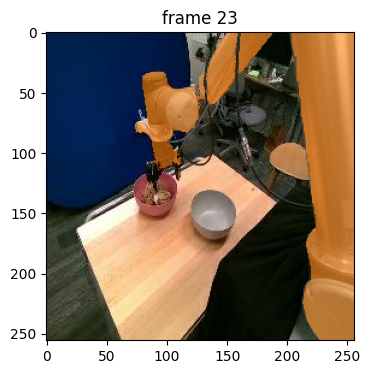

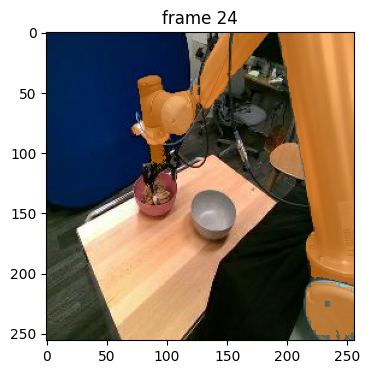

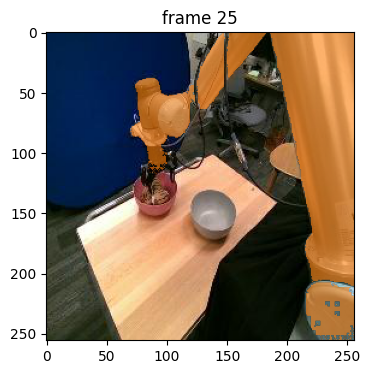

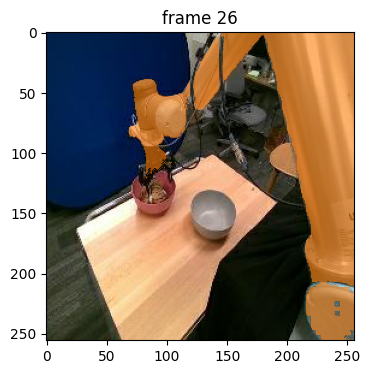

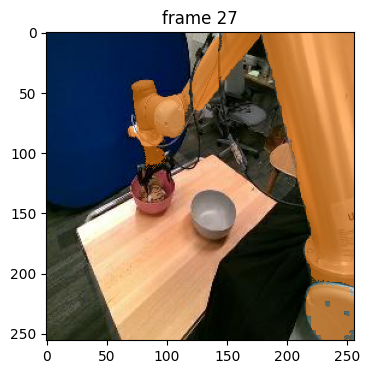

...

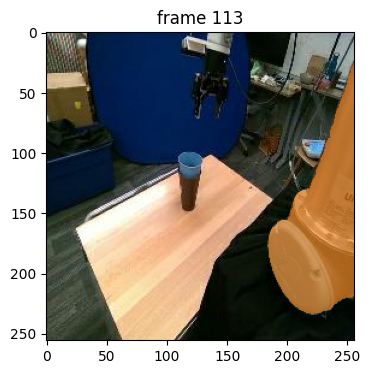

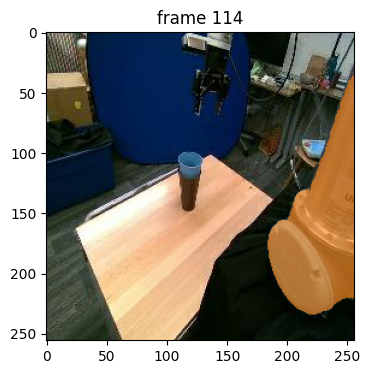

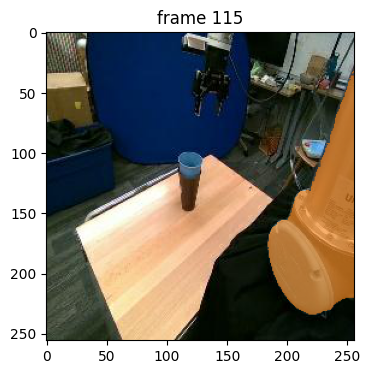

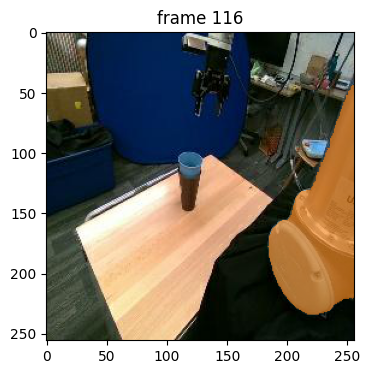

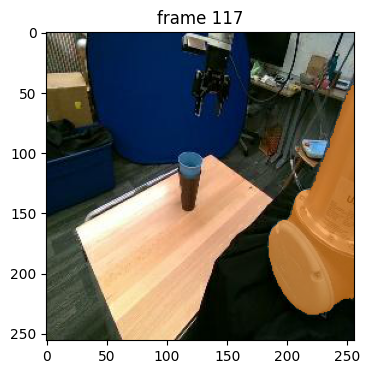

In [129]:
# run propagation throughout the video and collect the results in a dict
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# # Iterate over all frames
for out_frame_idx in range(ann_frame_idx, len(image_lists), 1):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(image_lists[out_frame_idx]))
    
    # Show and merge masks for each object in the frame
    masks = {}
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
        masks[out_obj_id] = out_mask
    
    save_path = os.path.join(mask_path, image_lists[out_frame_idx].split('/')[-2])
    # Save the merged mask
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    save_image_path = os.path.join(save_path, image_lists[out_frame_idx].split('/')[-1])
    print(save_image_path)
    merge_and_save_masks(masks, save_image_path)



In [125]:
len(inference_state)

21

The segments now look good on all frames.

### Example 2: Segment an object using box prompt

Note: if you have run any previous tracking using this `inference_state`, please reset it first via `reset_state`.

In addition to using clicks as inputs, SAM 2 also supports segmenting and tracking objects in a video via **bounding boxes**.

In the example below, we segment the child on the right using a **box prompt** of (x_min, y_min, x_max, y_max) = (300, 0, 500, 400) on frame 0 as input into the `add_new_points_or_box` API.

Here, SAM 2 gets a pretty good segmentation mask of the entire child, even though the input bounding box is not perfectly tight around the object.

Similar to the previous example, if the returned mask from is not perfect when using a box prompt, we can also further **refine** the output using positive or negative clicks. To illustrate this, here we make a **positive click** at (x, y) = (460, 60) with label `1` to expand the segment around the child's hair.

Note: to refine the segmentation mask from a box prompt, we need to send **both the original box input and all subsequent refinement clicks and their labels** when calling `add_new_points_or_box`.

Then, to get the masklet throughout the entire video, we propagate the prompts using the `propagate_in_video` API.

Note that in addition to clicks or boxes, SAM 2 also supports directly using a **mask prompt** as input via the `add_new_mask` method in the `SAM2VideoPredictor` class. This can be helpful in e.g. semi-supervised VOS evaluations (see [tools/vos_inference.py](https://github.com/facebookresearch/segment-anything-2/blob/main/tools/vos_inference.py) for an example).

### Example 3: Segment multiple objects simultaneously

Note: if you have run any previous tracking using this `inference_state`, please reset it first via `reset_state`.

#### Step 1: Add two objects on a frame

SAM 2 can also segment and track two or more objects at the same time. One way, of course, is to do them one by one. However, it would be more efficient to batch them together (e.g. so that we can share the image features between objects to reduce computation costs).

This time, let's focus on object parts and segment **the shirts of both childen** in this video. Here we add prompts for these two objects and assign each of them a unique object id.

Add the first object (the left child's shirt) with a **positive click** at (x, y) = (200, 300) on frame 0.

We assign it to object id `2` (it can be arbitrary integers, and only needs to be unique for each object to track), which is passed to the `add_new_points_or_box` API to distinguish the object we are clicking upon.

Hmm, this time we just want to select the child's shirt, but the model predicts the mask for the entire child. Let's refine the prediction with a **negative click** at (x, y) = (275, 175).

After the 2nd negative click, now we get the left child's shirt as our first object.

Let's move on to the second object (the right child's shirt) with a positive click at (x, y) = (400, 150) on frame 0. Here we assign object id `3` to this second object (it can be arbitrary integers, and only needs to be unique for each object to track).

Note: when there are multiple objects, the `add_new_points_or_box` API will return a list of masks for each object.

This time the model predicts the mask of the shirt we want to track in just one click. Nice!

#### Step 2: Propagate the prompts to get masklets across the video

Now, we propagate the prompts for both objects to get their masklets throughout the video.

Note: when there are multiple objects, the `propagate_in_video` API will return a list of masks for each object.

Looks like both children's shirts are well segmented in this video.

Now you can try SAM 2 on your own videos and use cases! 